# Tarea 1. UNet para SuperResolución

Aprendizaje de Máquina II, 2020

Oscar Esaú Peralta Rosales

Maestría en Ciencias con Especialidad en Computación


## Introducción

Esta tarea está basada en el paper de [Single Image Super Resolution based on a ModifiedU-netwith Mixed Gradient Loss](https://arxiv.org/pdf/1911.09428.pdf)

La arquitectura implementada se muestra a continuación:

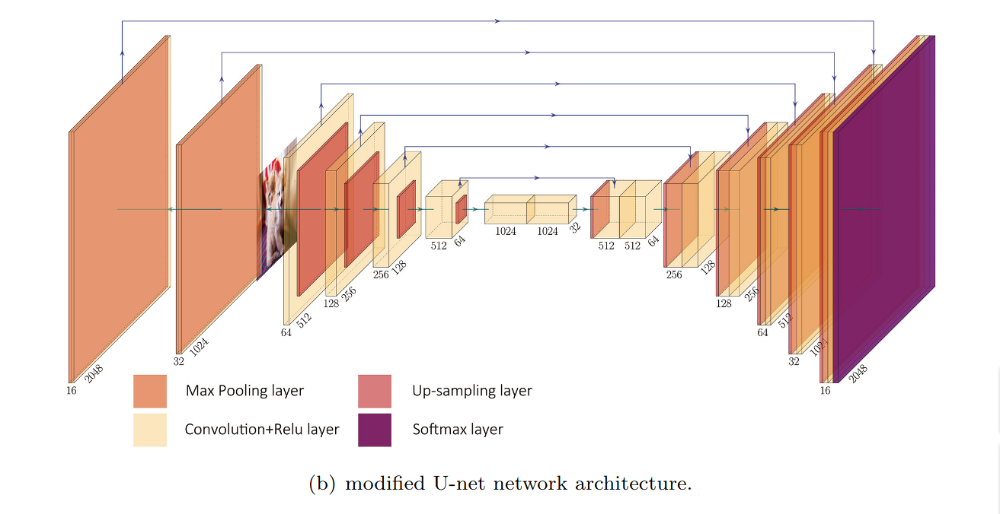

El modelo cuanta con dos tipos de bloques; de reducción y de expanción.

Los bloques de reducción están formados por una capa convolucional que duplica el número de canales seguida de una función de activación Relu y finalmente un max pooling que reduce las dimenciones espaciales de la imagen por un factor de 2.

Los bloques de expanción estan formados por una operación de UpSampling que
aumenta las dimenciones espacionales de la imagen x2 seguida de dos convoluciones.

Nótese que los skip connections que llegan a la primer convolución de bloque de expación.

A la salida de la red se aplica como función de activación Softmax.

Para obtener el resultado de escalar las dimenciones espaciales y mejorar la resoluición de la imágen. Se aplica directamente a la imagen de entrada tantos bloques expansivos se requieran para obtener las dimenciones deseadas y cuyo output sirve como skip conecctions para los últimos bloques expansivos


In [ ]:
import argparse
import time

import torch
import torch.nn as nn
import torch.nn.functional as F

import torchvision
import torchvision.transforms as transforms

import numpy as np

from PIL import Image
from matplotlib import pyplot as plt
from mpl_toolkits.axes_grid1 import ImageGrid

from tqdm.notebook import tqdm

In [ ]:
ENV = argparse.ArgumentParser().parse_args([])

## Carga de Datos

Usamos directamente la base de datos de CIFAR-10.
Contamos con 50 mil imágenes para entrenamiento y 10 mil para prueba

In [ ]:
trainset = torchvision.datasets.CIFAR10(root='./data', train=True, download=True)
testset = torchvision.datasets.CIFAR10(root='./data', train=False, download=True)
trainset.data.shape, testset.data.shape

Files already downloaded and verified
Files already downloaded and verified


((50000, 32, 32, 3), (10000, 32, 32, 3))

In [ ]:
ENV.batch_size = 128
ENV.img_size = trainset.data[0].shape
ENV.resize_factor = 2

Nuestro data loader nos permite procesar las imágenes por batch en el entrenamiento.

In [ ]:
class Dataloader(torch.utils.data.Dataset):
    def __init__(self, dataset, batch_size, x_transform, y_transform, shuffle:bool=False):
        """ Data generator
            Args:
                dataset: datasets to use from Torchvision
                batch_size: Batch size
                x_transform: Transforms to apply to the inputs
                y_transform: Transforms to apply to the inputs
                suffle: If a suffle is apply before each iteration
            
            Returns:
                Tuple: (inputs, targets)
        """
        self.dataset = dataset
        self.batch_size = batch_size
        self.x_transform = x_transform
        self.y_transform = y_transform
        self.shuffle = shuffle

        self.batch_step = 0
        self.batch_idx = None
        self.indexes = np.arange(self.dataset.data.shape[0])
        if self.shuffle is True:
            np.random.shuffle(self.indexes)

        self.__preprocess()


    def __preprocess(self):
        self.x_data = torch.stack([self.x_transform(dt) for dt in self.dataset.data])
        self.y_data = torch.stack([self.y_transform(dt) for dt in self.dataset.data])


    def __len__(self):
        return self.dataset.data.shape[0] // self.batch_size


    def __getitem__(self, index):
        self.batch_idx = self.indexes[index*self.batch_size : (index+1)*self.batch_size]
        x_data = self.x_data[self.batch_idx, :]
        y_data = self.y_data[self.batch_idx, :]

        return x_data, y_data 


    def __iter__(self):
        return self


    def __next__(self):
        if self.batch_step == self.__len__():
            self.__on_epoch_end()
            raise StopIteration()

        batch = self.__getitem__(self.batch_step)
        self.batch_step += 1

        return batch


    def __on_epoch_end(self):
        self.batch_step = 0
        if self.shuffle is True:
            np.random.shuffle(self.indexes)


Las imágenes usadas como input de la red, son reducidas a la mitad de tamaño para ser recuperadas del tamaño original.

Se normalizan al rango {-1, 1}

In [ ]:
# Reducimos las imágenes x2 para bajarle la resolución y calidad de imágenes
x_transform = transforms.Compose([
    Image.fromarray,
    transforms.Resize(size=(ENV.img_size[0] // ENV.resize_factor, ENV.img_size[1] // ENV.resize_factor)),
    # transforms.Resize(size=(ENV.img_size[0], ENV.img_size[1])),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

y_transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

Creamos el generador de datos para entrenamiento y prueba. No es gran cantidad de datos así que puede ser cargado todo a memoria RAM.

In [ ]:
train_loader = Dataloader(trainset, batch_size=ENV.batch_size, x_transform=x_transform, y_transform=y_transform, shuffle=True)
test_loader = Dataloader(testset, batch_size=ENV.batch_size, x_transform=x_transform, y_transform=y_transform, shuffle=False)

## Ejemplo de input

In [ ]:
def imshow(img):
    fig = plt.figure(figsize=(19.2, 10.8))
    img = img / 2 + 0.5     # unnormalize
    npimg = img.numpy()
    plt.imshow(np.transpose(npimg, (1, 2, 0)))
    plt.show()

In [ ]:
train_gen = iter(train_loader)
x_data, y_data = next(train_gen)
x_data.shape, y_data.shape

(torch.Size([128, 3, 16, 16]), torch.Size([128, 3, 32, 32]))

### Baja Resolución

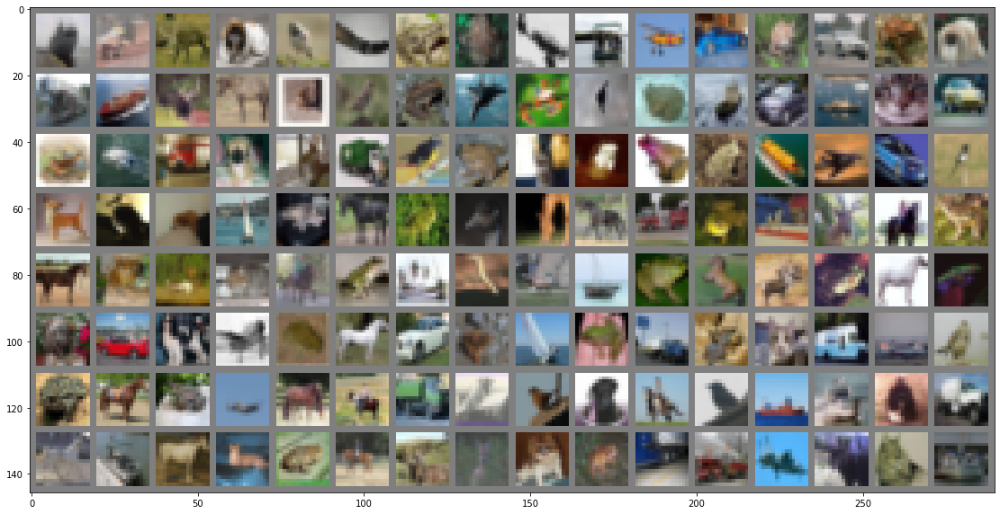

In [ ]:
imshow(torchvision.utils.make_grid(x_data, nrow=16))

### Resolución original

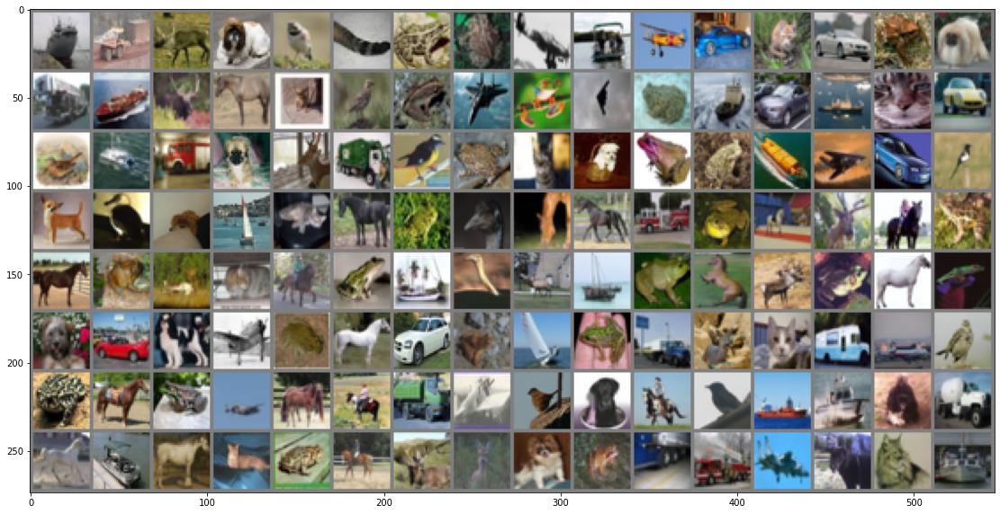

In [ ]:
imshow(torchvision.utils.make_grid(y_data, nrow=16))

## Modelo

### Detalles de la implementación

Definimos un bloque base que realiza una convolución y aplica la función Relu a la salida

In [ ]:
class ConvRelu(nn.Module):
    def __init__(self, kernel_size, filters, in_channels, no_activation=False):
        super(ConvRelu, self).__init__()
        self.kernel_size = kernel_size
        self.filters = filters
        self.in_channels = in_channels
        self.no_activation = no_activation
        self.build()

    def build(self):
        self.conv_1 = nn.Conv2d(in_channels=self.in_channels, 
                                out_channels=self.filters, 
                                kernel_size=self.kernel_size,
                                padding=(self.kernel_size[0] - 1) // 2,
                                padding_mode='zeros')

    def forward(self, inputs):
        if self.no_activation:
            return self.conv_1(inputs)
        return F.relu(self.conv_1(inputs))

El bloque de reducción formado por:

convolución => Relu => Max pooling

Retorna la salida de la convolución y la salida final. La salida de la convolución es usada como skip connection para los bloques de expanción.

In [ ]:
class ContractingBlock(nn.Module):
    def __init__(self, kernel_size, filters, in_channels):
        super(ContractingBlock, self).__init__()
        self.kernel_size = kernel_size
        self.filters = filters
        self.in_channels = in_channels
        self.build()
    
    
    def build(self):
        self.convr_1 = ConvRelu(kernel_size=self.kernel_size,
                                filters=self.filters,
                                in_channels=self.in_channels)
        self.max_pool = nn.MaxPool2d(kernel_size=(2, 2))
    

    def forward(self, inputs):
        out1 = self.convr_1(inputs)
        out2 = self.max_pool(out1)

        return out1, out2

El bloque de expanción está formado por un Upsampling seguido de dos bloques de convolución con sus respectivos relu.

Este bloque recibe el input a procesarse y el skip connection, y los concatena por canales

In [ ]:
class ExpansiveBlock(nn.Module):
    def __init__(self, kernel_size, filters, in_channels, scale_factor=(2, 2), use_skip=True):
        super(ExpansiveBlock, self).__init__()
        self.kernel_size = kernel_size
        self.filters = filters
        self.in_channels = in_channels
        self.scale_factor = scale_factor
        self.use_skip = use_skip
        self.build()
    
    
    def build(self):
        self.up = nn.Upsample(scale_factor=self.scale_factor,
                              mode='bicubic',
                              align_corners=False)
        self.convr_1 = ConvRelu(kernel_size=self.kernel_size,
                                filters=self.filters,
                                in_channels=self.in_channels)
        if self.use_skip:
            self.convr_2 = ConvRelu(kernel_size=self.kernel_size,
                                    filters=self.filters,
                                    in_channels=self.filters * 2)
    

    def forward(self, inputs, inputs_skip=None):
        out = self.up(inputs)
        out = self.convr_1(out)

        if not self.use_skip:
            return out

        out = torch.cat([out, inputs_skip], dim=1)
        out = self.convr_2(out)
        return out

El modelo está formado por 3 ContractingBlock's, 2 ConvRelu como cuello de botella y 5 ExpansiveBlock cuyos últimos son usandos para escalar las dimenciones espaciales de la imágen a las deseadas. La idea es agregar tantos pares de ExpansiveBlock al final y al inicio de la red para obtener la escala deseada.

En este caso como solo vamos a duplicar la resolución agregamos un par.

Como salida agregamos un último bloque convolucional para reducir el número de canales a 3 (RGB) y con función de activación tanh para obtener una salida entre {-1, 1}

In [ ]:
class SRUnet(nn.Module):
    def __init__(self, start_channels=64):
        super(SRUnet, self).__init__()
        self.start_channels = start_channels
        self.build()
    
    
    def build(self):
        self.down_1 = ContractingBlock(kernel_size=(3, 3), 
                                       filters=self.start_channels,
                                       in_channels=3)
        self.down_2 = ContractingBlock(kernel_size=(3, 3), 
                                       filters=self.start_channels*2,
                                       in_channels=self.start_channels)
        self.down_3 = ContractingBlock(kernel_size=(3, 3), 
                                       filters=self.start_channels*4,
                                       in_channels=self.start_channels*2)

        self.convr_1 = ConvRelu(kernel_size=(3, 3),
                                filters=self.start_channels*8,
                                in_channels=self.start_channels*4)
        self.convr_2 = ConvRelu(kernel_size=(3, 3),
                                filters=self.start_channels*8,
                                in_channels=self.start_channels*8)

        self.up_1 = ExpansiveBlock(kernel_size=(3, 3),
                                   filters=self.start_channels*4,
                                   in_channels=self.start_channels*8,
                                   scale_factor=(2, 2),
                                   use_skip=True)
        self.up_2 = ExpansiveBlock(kernel_size=(3, 3),
                                   filters=self.start_channels*2,
                                   in_channels=self.start_channels*4,
                                   scale_factor=(2, 2),
                                   use_skip=True)
        self.up_3 = ExpansiveBlock(kernel_size=(3, 3),
                                   filters=self.start_channels,
                                   in_channels=self.start_channels*2,
                                   scale_factor=(2, 2),
                                   use_skip=True)

        self.up_4 = ExpansiveBlock(kernel_size=(3, 3),
                                   filters=self.start_channels // 2,
                                   in_channels=self.start_channels,
                                   scale_factor=(2, 2),
                                   use_skip=True)

        self.direct_up = ExpansiveBlock(kernel_size=(3, 3),
                                        filters=self.start_channels // 2,
                                        in_channels=3,
                                        scale_factor=(2, 2),
                                        use_skip=False)
        
        self.last_convr = ConvRelu(kernel_size=(3, 3),
                                   filters=3,
                                   in_channels=self.start_channels // 2,
                                   no_activation=True)
    

    def forward(self, inputs):
        # Contracting blocks
        d1_skip, d1 = self.down_1(inputs)
        d2_skip, d2 = self.down_2(d1)
        d3_skip, d3 = self.down_3(d2)

        # Bottle neck
        i1 = self.convr_1(d3)
        i2 = self.convr_2(i1)

        # Expansive blocks
        u1 = self.up_1(i2, inputs_skip=d3_skip)
        u2 = self.up_2(u1, inputs_skip=d2_skip)
        u3 = self.up_3(u2, inputs_skip=d1_skip)
        u4 = self.up_4(u3, inputs_skip=self.direct_up(inputs))

        out = self.last_convr(u4)

        return torch.tanh(out)

## Training

La función de costo usada es basada en la presentada en el artículo a excepción que usamos norma L1 en vez de L2

In [ ]:
def my_loss(alpha_1, alpha_2):
    """ Función de costo MSE + mean gradient error

        ref: https://arxiv.org/pdf/1911.09428.pdf
    """
    # The two kernels for Sobel operator
    dx = torch.Tensor([
        [1, 0, -1],
        [2, 0, -2],
        [1, 0, -1]  
    ])
    dy = torch.Tensor([
        [1, 2, 1],
        [0, 0, 0],
        [-1, -2, -1]
    ])
    
    dx = dx.view((1, 1, 3, 3))
    dy = dy.view((1, 1, 3, 3))
    Dx = torch.cat([dx, dx, dx]).to(ENV.device)
    Dy = torch.cat([dy, dy, dy]).to(ENV.device)

    def __loss(outputs, targets):
        residual = outputs - targets
        l1_error = torch.norm(residual, p=1)

        l1_grad_error = torch.abs(F.conv2d(input=residual, weight=Dx, groups=3)) + \
                  torch.abs(F.conv2d(input=residual, weight=Dy, groups=3))
        return alpha_1 * l1_error + alpha_2 * torch.sum(l1_grad_error)
    
    return __loss


Evaluación sobre el conjunto de prueba

In [ ]:
def test_evaluation(model):
    """ Evaluación sobre los datos de prueba """
    model.eval()
    with torch.no_grad():
        losses = []
        last_out = None
        for nbatch, (x_data, y_data) in tqdm(enumerate(test_loader, 1), ascii=True, total=len(test_loader)):
            inputs, targets = x_data.to(ENV.device), y_data.to(ENV.device)
            y_pred = model(inputs)
            last_out = inputs, y_pred, targets
            losses.append(criterion(y_pred, targets).cpu().numpy())
        print("Test loss: ", np.mean(losses))
    return last_out


In [ ]:
def show_samples(inputs, outputs, targets, idxs, nsamples):
    """ Muestras de los resultados de la red

        Primer fila inputs
        Segunda fila ouputs de la red
        Tercera fila original
    """
    fig = plt.figure(figsize=(19.2, 10.8))
    grid = ImageGrid(fig, 111,
                     nrows_ncols=(3, nsamples),
                     axes_pad=0.1)

    data = [np.transpose(img / 2 + 0.5, (1, 2, 0)) for img in inputs[idxs]]
    data += [np.transpose(img / 2 + 0.5, (1, 2, 0)) for img in outputs[idxs]]
    data += [np.transpose(img / 2 + 0.5, (1, 2, 0)) for img in targets[idxs]]

    tr = transforms.Resize(size=(ENV.img_size[0], ENV.img_size[1]))

    for i, (ax, img) in enumerate(zip(grid, data)):
        if i < len(idxs):
            img = np.uint8(img*255)
            img = tr(Image.fromarray(img))

        ax.imshow(img)

    plt.show()

Usamos CUDA si está disponible o en su defecto CPU

In [ ]:
ENV.device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(ENV.device)

cuda:0


Creamos nuestro modelo 

In [112]:
model = SRUnet().to(ENV.device)

Epoch:  1


 Number of seen samples: 2688 loss: 128852.526953125
 Number of seen samples: 5248 loss: 78278.4328125
 Number of seen samples: 7808 loss: 66168.0794921875
 Number of seen samples: 10368 loss: 58141.8
 Number of seen samples: 12928 loss: 54986.2052734375
 Number of seen samples: 15488 loss: 51591.5232421875
 Number of seen samples: 18048 loss: 50379.6796875
 Number of seen samples: 20608 loss: 48872.8779296875
 Number of seen samples: 23168 loss: 48337.43515625
 Number of seen samples: 25728 loss: 47026.994140625
 Number of seen samples: 28288 loss: 46840.7908203125
 Number of seen samples: 30848 loss: 46468.2373046875
 Number of seen samples: 33408 loss: 45559.1078125
 Number of seen samples: 35968 loss: 44969.798828125
 Number of seen samples: 38528 loss: 44690.53515625
 Number of seen samples: 41088 loss: 44800.411328125
 Number of seen samples: 43648 loss: 44742.2828125
 Number of seen samples: 46208 loss: 43983.1560546875
 Number of seen samples: 48768 loss: 43440.2486328125

Mode


Test loss:  43461.97


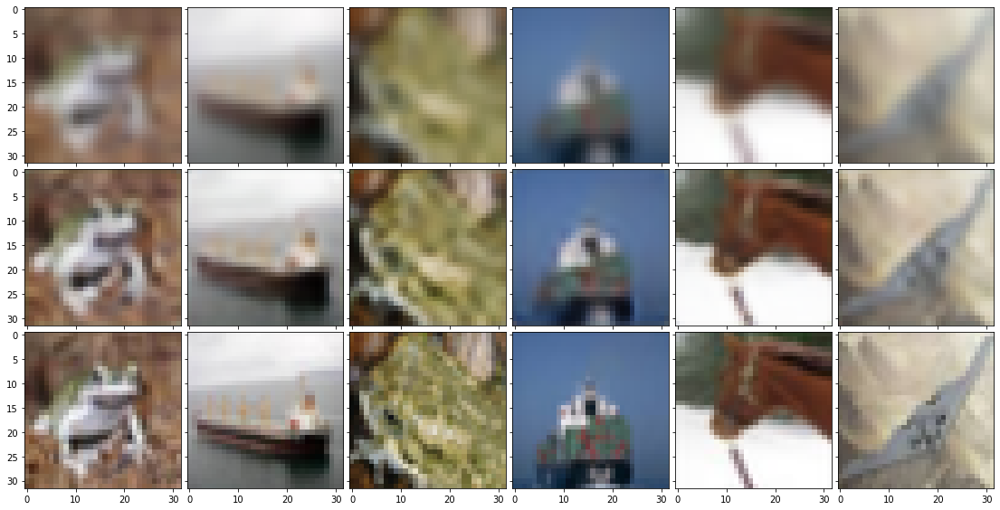

Epoch:  2


 Number of seen samples: 2688 loss: 43223.744921875
 Number of seen samples: 5248 loss: 43361.9787109375
 Number of seen samples: 7808 loss: 43096.58046875
 Number of seen samples: 10368 loss: 43142.1376953125
 Number of seen samples: 12928 loss: 42600.7052734375
 Number of seen samples: 15488 loss: 42864.57734375
 Number of seen samples: 18048 loss: 42621.3974609375
 Number of seen samples: 20608 loss: 42333.7421875
 Number of seen samples: 23168 loss: 42558.5044921875
 Number of seen samples: 25728 loss: 42014.27890625
 Number of seen samples: 28288 loss: 41831.08515625
 Number of seen samples: 30848 loss: 41893.544921875
 Number of seen samples: 33408 loss: 41749.4158203125
 Number of seen samples: 35968 loss: 41896.39453125
 Number of seen samples: 38528 loss: 41209.1814453125
 Number of seen samples: 41088 loss: 40995.3140625
 Number of seen samples: 43648 loss: 41646.1669921875
 Number of seen samples: 46208 loss: 40994.17265625
 Number of seen samples: 48768 loss: 41343.32402343


Test loss:  41134.812


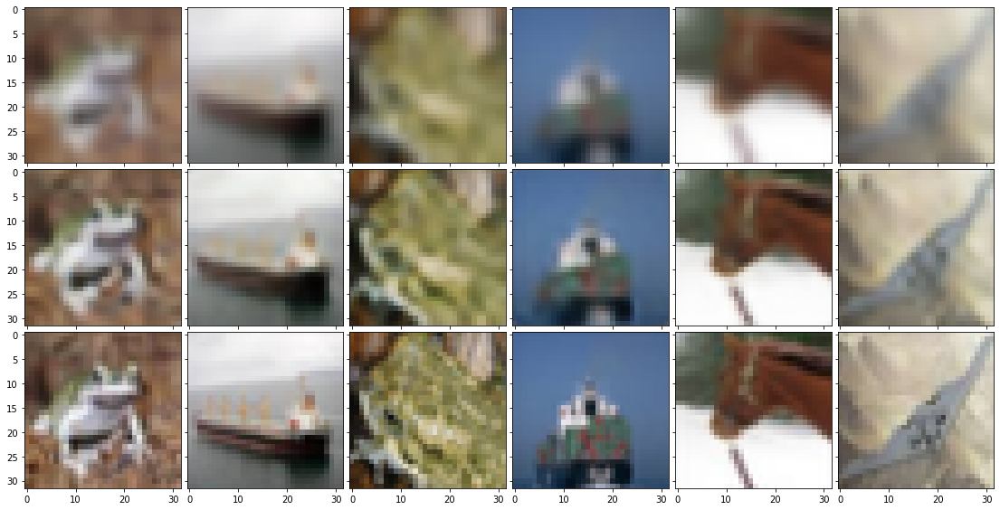

Epoch:  3


 Number of seen samples: 2688 loss: 40892.7193359375
 Number of seen samples: 5248 loss: 40690.476953125
 Number of seen samples: 7808 loss: 40548.45703125
 Number of seen samples: 10368 loss: 40221.8517578125
 Number of seen samples: 12928 loss: 40695.7890625
 Number of seen samples: 15488 loss: 40809.846484375
 Number of seen samples: 18048 loss: 40556.1318359375
 Number of seen samples: 20608 loss: 40196.696875
 Number of seen samples: 23168 loss: 40534.20703125
 Number of seen samples: 25728 loss: 40475.469140625
 Number of seen samples: 28288 loss: 40306.9421875
 Number of seen samples: 30848 loss: 39833.630078125
 Number of seen samples: 33408 loss: 39976.8921875
 Number of seen samples: 35968 loss: 39781.8490234375
 Number of seen samples: 38528 loss: 40250.7673828125
 Number of seen samples: 41088 loss: 39695.859375
 Number of seen samples: 43648 loss: 39941.1498046875
 Number of seen samples: 46208 loss: 39582.83359375
 Number of seen samples: 48768 loss: 39826.851171875

Mode


Test loss:  39517.785


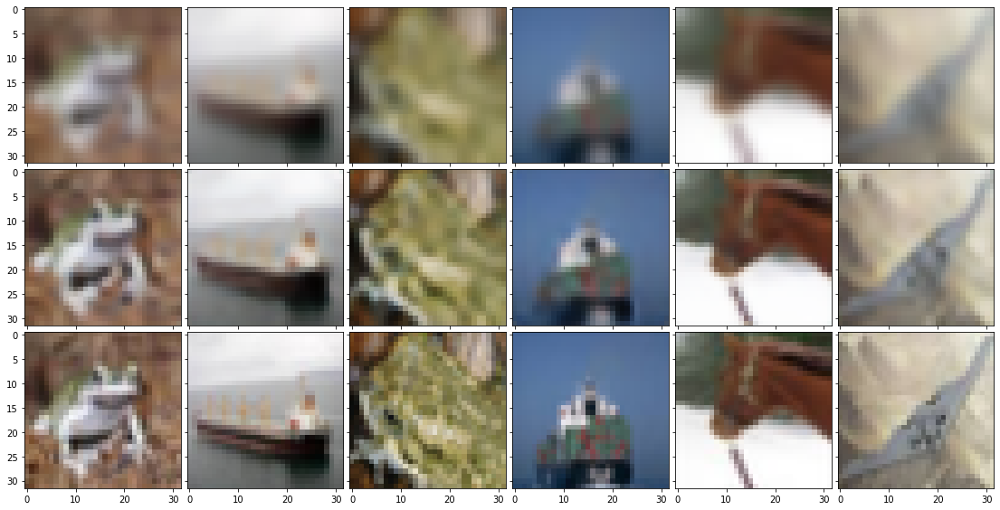

Epoch:  4


 Number of seen samples: 2688 loss: 39481.1283203125
 Number of seen samples: 5248 loss: 39843.77109375
 Number of seen samples: 7808 loss: 39014.9353515625
 Number of seen samples: 10368 loss: 39431.893359375
 Number of seen samples: 12928 loss: 39070.1994140625
 Number of seen samples: 15488 loss: 39613.8236328125
 Number of seen samples: 18048 loss: 39531.948046875
 Number of seen samples: 20608 loss: 39100.99375
 Number of seen samples: 23168 loss: 39059.684375
 Number of seen samples: 25728 loss: 39161.1220703125
 Number of seen samples: 28288 loss: 39190.3021484375
 Number of seen samples: 30848 loss: 39781.084765625
 Number of seen samples: 33408 loss: 39110.2765625
 Number of seen samples: 35968 loss: 39065.1150390625
 Number of seen samples: 38528 loss: 38973.948828125
 Number of seen samples: 41088 loss: 39252.7390625
 Number of seen samples: 43648 loss: 39624.2201171875
 Number of seen samples: 46208 loss: 38863.5001953125
 Number of seen samples: 48768 loss: 38423.2

Model 


Test loss:  38852.703


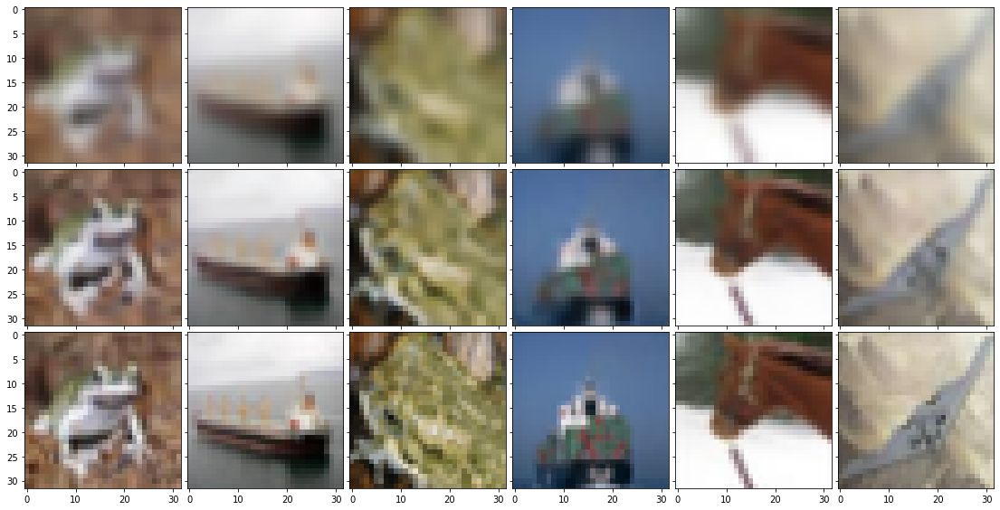

Epoch:  5


 Number of seen samples: 2688 loss: 39078.6654296875
 Number of seen samples: 5248 loss: 39075.939453125
 Number of seen samples: 7808 loss: 38747.7798828125
 Number of seen samples: 10368 loss: 38811.281640625
 Number of seen samples: 12928 loss: 38423.754296875
 Number of seen samples: 15488 loss: 38702.848828125
 Number of seen samples: 18048 loss: 38853.4345703125
 Number of seen samples: 20608 loss: 38811.0435546875
 Number of seen samples: 23168 loss: 38633.66015625
 Number of seen samples: 25728 loss: 38228.6423828125
 Number of seen samples: 28288 loss: 38960.67578125
 Number of seen samples: 30848 loss: 38652.652734375
 Number of seen samples: 33408 loss: 38609.9390625
 Number of seen samples: 35968 loss: 38418.6892578125
 Number of seen samples: 38528 loss: 37971.843359375
 Number of seen samples: 41088 loss: 38829.173828125
 Number of seen samples: 43648 loss: 38208.0423828125
 Number of seen samples: 46208 loss: 38641.966015625
 Number of seen samples: 48768 loss: 38304.283


Test loss:  38399.33


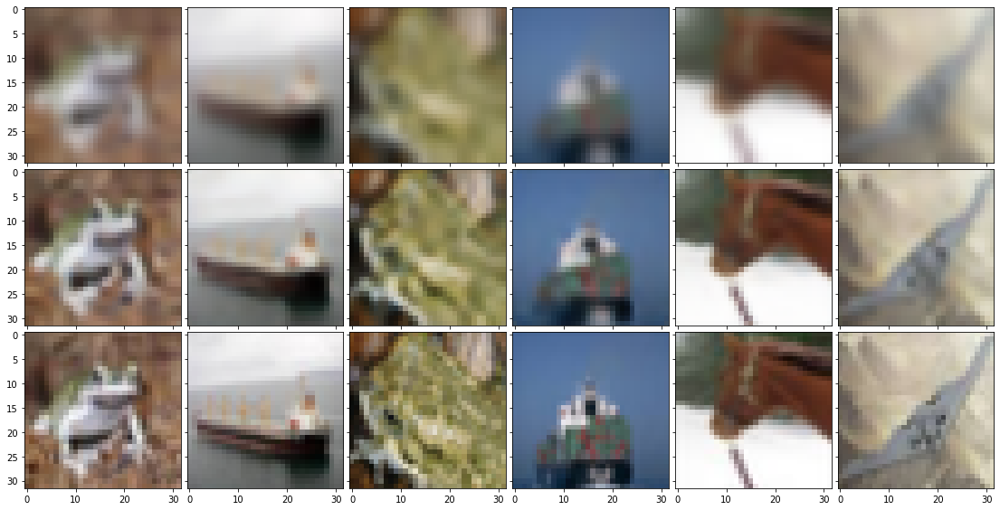

Epoch:  6


 Number of seen samples: 2688 loss: 38768.1521484375
 Number of seen samples: 5248 loss: 37835.4671875
 Number of seen samples: 7808 loss: 38489.256640625
 Number of seen samples: 10368 loss: 38472.6666015625
 Number of seen samples: 12928 loss: 38184.1099609375
 Number of seen samples: 15488 loss: 38053.970703125
 Number of seen samples: 18048 loss: 38548.816015625
 Number of seen samples: 20608 loss: 38341.3158203125
 Number of seen samples: 23168 loss: 37879.4435546875
 Number of seen samples: 25728 loss: 37679.6720703125
 Number of seen samples: 28288 loss: 37953.39375
 Number of seen samples: 30848 loss: 38069.746875
 Number of seen samples: 33408 loss: 38295.6384765625
 Number of seen samples: 35968 loss: 37936.5033203125
 Number of seen samples: 38528 loss: 38314.96875
 Number of seen samples: 41088 loss: 37870.66015625
 Number of seen samples: 43648 loss: 38310.35234375
 Number of seen samples: 46208 loss: 38287.8421875
 Number of seen samples: 48768 loss: 38295.5072265625

Mod


Test loss:  37943.066


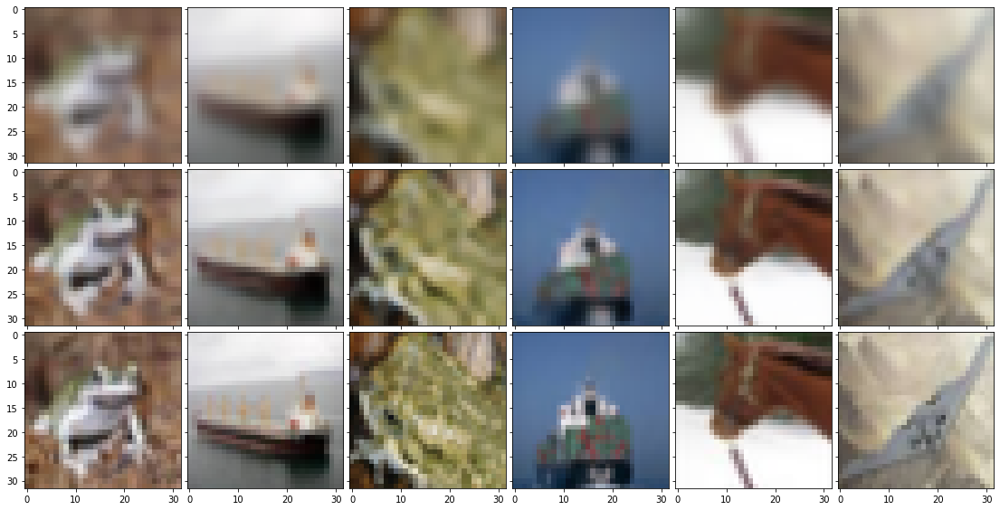

Epoch:  7


 Number of seen samples: 2688 loss: 37711.8828125
 Number of seen samples: 5248 loss: 38252.35390625
 Number of seen samples: 7808 loss: 37750.4375
 Number of seen samples: 10368 loss: 37846.3552734375
 Number of seen samples: 12928 loss: 37622.7634765625
 Number of seen samples: 15488 loss: 37775.7158203125
 Number of seen samples: 18048 loss: 37956.3759765625
 Number of seen samples: 20608 loss: 37553.093359375
 Number of seen samples: 23168 loss: 38055.56640625
 Number of seen samples: 25728 loss: 38026.8521484375
 Number of seen samples: 28288 loss: 38216.9712890625
 Number of seen samples: 30848 loss: 38136.6361328125
 Number of seen samples: 33408 loss: 38009.508203125
 Number of seen samples: 35968 loss: 37950.2716796875
 Number of seen samples: 38528 loss: 37993.497265625
 Number of seen samples: 41088 loss: 37719.55234375
 Number of seen samples: 43648 loss: 37750.186328125
 Number of seen samples: 46208 loss: 37506.2701171875
 Number of seen samples: 48768 loss: 37649.1509765


Test loss:  37673.062


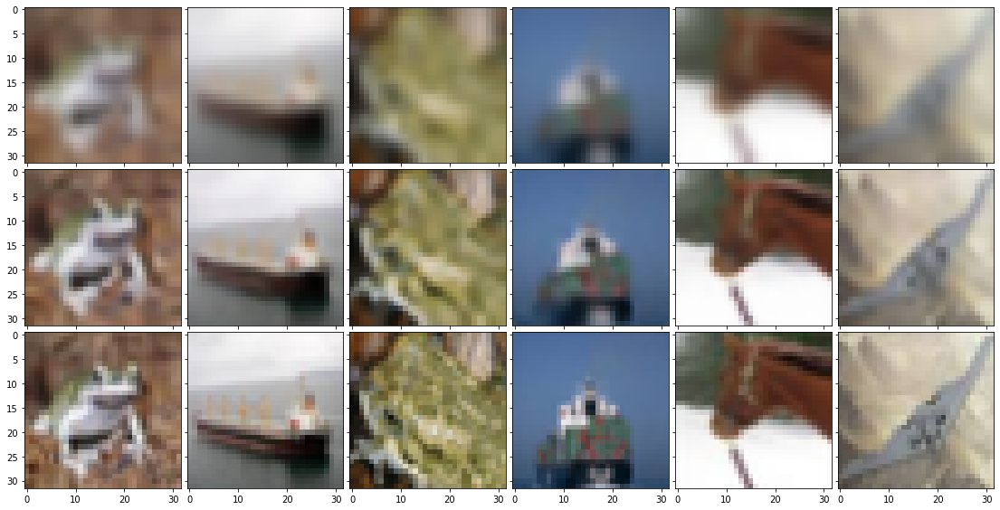

Epoch:  8


 Number of seen samples: 2688 loss: 37388.940234375
 Number of seen samples: 5248 loss: 37444.326171875
 Number of seen samples: 7808 loss: 37870.3248046875
 Number of seen samples: 10368 loss: 37589.55859375
 Number of seen samples: 12928 loss: 37591.803125
 Number of seen samples: 15488 loss: 37854.840234375
 Number of seen samples: 18048 loss: 38006.9197265625
 Number of seen samples: 20608 loss: 37531.54921875
 Number of seen samples: 23168 loss: 37652.7255859375
 Number of seen samples: 25728 loss: 37212.0748046875
 Number of seen samples: 28288 loss: 37149.79453125
 Number of seen samples: 30848 loss: 37453.9400390625
 Number of seen samples: 33408 loss: 37311.2822265625
 Number of seen samples: 35968 loss: 37592.0345703125
 Number of seen samples: 38528 loss: 37670.43828125
 Number of seen samples: 41088 loss: 37678.0720703125
 Number of seen samples: 43648 loss: 37502.0162109375
 Number of seen samples: 46208 loss: 37401.9271484375
 Number of seen samples: 48768 loss: 37368.673


Test loss:  37509.68


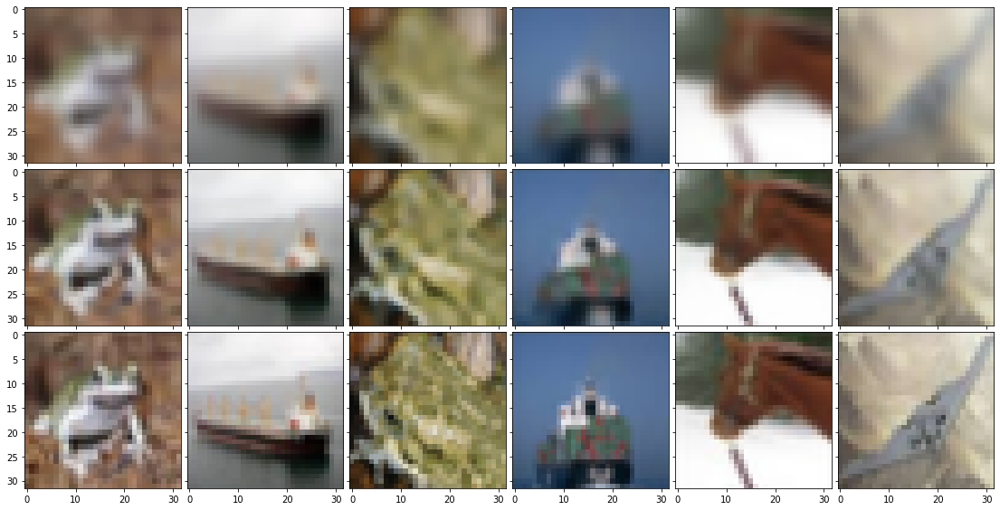

Epoch:  9


 Number of seen samples: 2688 loss: 37291.2169921875
 Number of seen samples: 5248 loss: 37427.836328125
 Number of seen samples: 7808 loss: 37657.6591796875
 Number of seen samples: 10368 loss: 37554.1080078125
 Number of seen samples: 12928 loss: 37257.91796875
 Number of seen samples: 15488 loss: 37274.9423828125
 Number of seen samples: 18048 loss: 37438.569921875
 Number of seen samples: 20608 loss: 37407.9591796875
 Number of seen samples: 23168 loss: 37477.3716796875
 Number of seen samples: 25728 loss: 37165.05078125
 Number of seen samples: 28288 loss: 37366.63125
 Number of seen samples: 30848 loss: 37083.5322265625
 Number of seen samples: 33408 loss: 37599.3646484375
 Number of seen samples: 35968 loss: 37549.8888671875
 Number of seen samples: 38528 loss: 37359.01015625
 Number of seen samples: 41088 loss: 37418.4828125
 Number of seen samples: 43648 loss: 36996.1873046875
 Number of seen samples: 46208 loss: 37370.9318359375
 Number of seen samples: 48768 loss: 37297.3875


Test loss:  37335.918


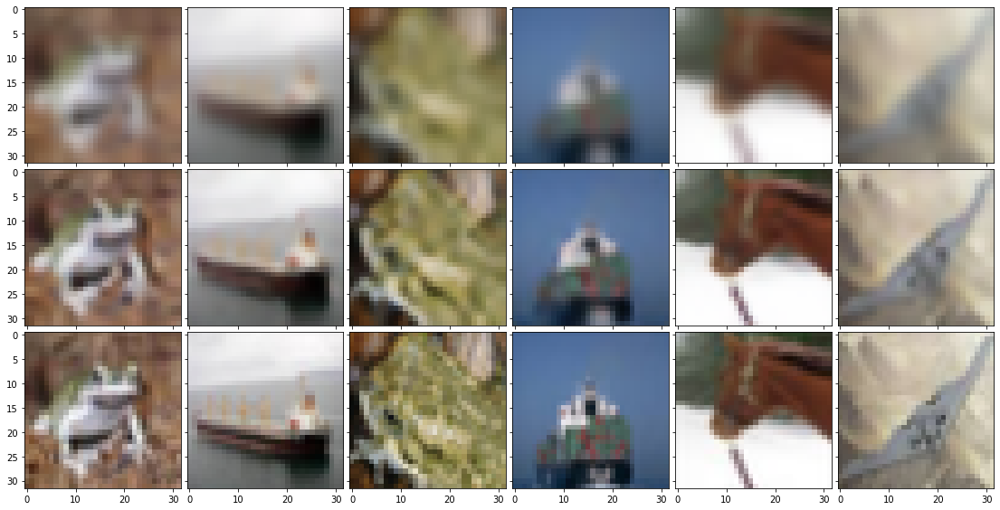

Epoch:  10


 Number of seen samples: 2688 loss: 37259.8044921875
 Number of seen samples: 5248 loss: 37022.668359375
 Number of seen samples: 7808 loss: 36807.452734375
 Number of seen samples: 10368 loss: 37002.345703125
 Number of seen samples: 12928 loss: 37172.586328125
 Number of seen samples: 15488 loss: 37246.0732421875
 Number of seen samples: 18048 loss: 37296.7818359375
 Number of seen samples: 20608 loss: 37034.7677734375
 Number of seen samples: 23168 loss: 36974.680859375
 Number of seen samples: 25728 loss: 37145.2017578125
 Number of seen samples: 28288 loss: 37242.12890625
 Number of seen samples: 30848 loss: 37198.2248046875
 Number of seen samples: 33408 loss: 36898.791796875
 Number of seen samples: 35968 loss: 37304.06484375
 Number of seen samples: 38528 loss: 37238.1400390625
 Number of seen samples: 41088 loss: 37605.07578125
 Number of seen samples: 43648 loss: 37398.3751953125
 Number of seen samples: 46208 loss: 37194.590625
 Number of seen samples: 48768 loss: 36985.2027


Test loss:  37266.434


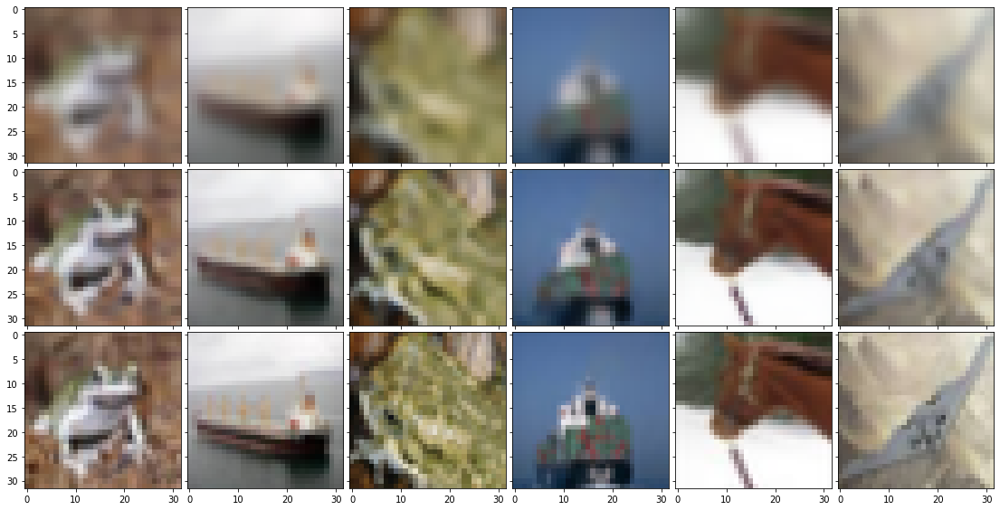

Epoch:  11


 Number of seen samples: 2688 loss: 36523.783984375
 Number of seen samples: 5248 loss: 37002.7037109375
 Number of seen samples: 7808 loss: 37393.6080078125
 Number of seen samples: 10368 loss: 36711.248828125
 Number of seen samples: 12928 loss: 36998.68828125
 Number of seen samples: 15488 loss: 36909.616796875
 Number of seen samples: 18048 loss: 37088.253515625
 Number of seen samples: 20608 loss: 36836.6771484375
 Number of seen samples: 23168 loss: 36776.726171875
 Number of seen samples: 25728 loss: 37339.264453125
 Number of seen samples: 28288 loss: 37004.058203125
 Number of seen samples: 30848 loss: 36697.5994140625
 Number of seen samples: 33408 loss: 36852.06015625
 Number of seen samples: 35968 loss: 37158.459765625
 Number of seen samples: 38528 loss: 36708.82578125
 Number of seen samples: 41088 loss: 36909.8576171875
 Number of seen samples: 43648 loss: 36819.2412109375
 Number of seen samples: 46208 loss: 37079.3818359375
 Number of seen samples: 48768 loss: 37074.67


Test loss:  37048.55


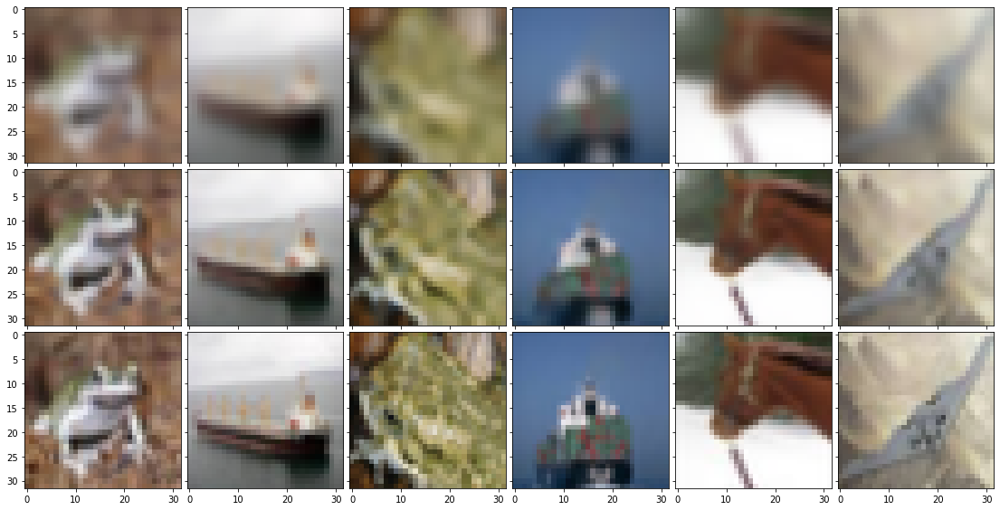

Epoch:  12


 Number of seen samples: 2688 loss: 36642.464453125
 Number of seen samples: 5248 loss: 36533.450390625
 Number of seen samples: 7808 loss: 36529.6125
 Number of seen samples: 10368 loss: 36560.2763671875
 Number of seen samples: 12928 loss: 36823.7892578125
 Number of seen samples: 15488 loss: 36940.4880859375
 Number of seen samples: 18048 loss: 36576.5263671875
 Number of seen samples: 20608 loss: 36904.252734375
 Number of seen samples: 23168 loss: 36703.5810546875
 Number of seen samples: 25728 loss: 36979.3720703125
 Number of seen samples: 28288 loss: 37041.5421875
 Number of seen samples: 30848 loss: 36781.746484375
 Number of seen samples: 33408 loss: 36697.2392578125
 Number of seen samples: 35968 loss: 37256.5689453125
 Number of seen samples: 38528 loss: 36711.8998046875
 Number of seen samples: 41088 loss: 36881.8244140625
 Number of seen samples: 43648 loss: 36950.7021484375
 Number of seen samples: 46208 loss: 36808.5572265625
 Number of seen samples: 48768 loss: 37116.1


Test loss:  36878.168


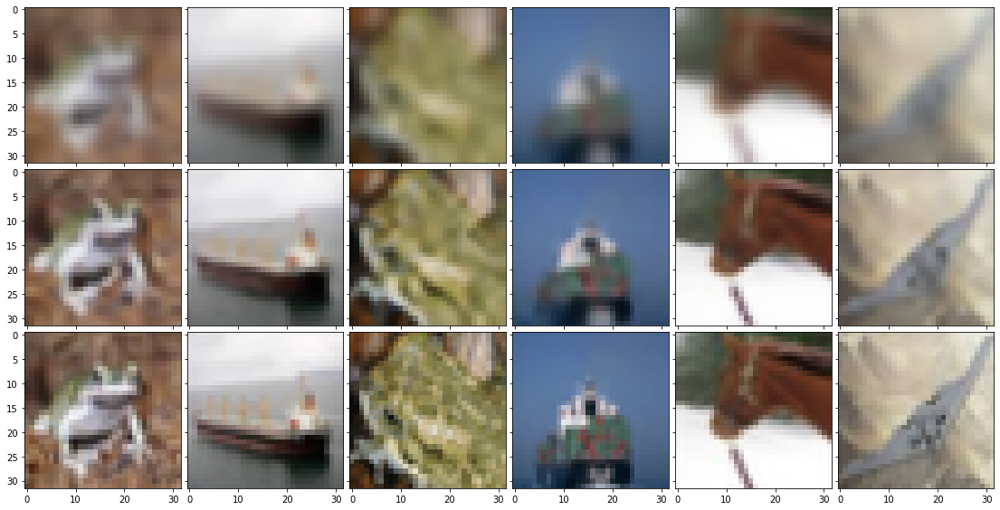

Epoch:  13


 Number of seen samples: 2688 loss: 36606.2603515625
 Number of seen samples: 5248 loss: 36494.7064453125
 Number of seen samples: 7808 loss: 36668.3603515625
 Number of seen samples: 10368 loss: 36535.5099609375
 Number of seen samples: 12928 loss: 36471.4818359375
 Number of seen samples: 15488 loss: 36694.785546875
 Number of seen samples: 18048 loss: 36523.4623046875
 Number of seen samples: 20608 loss: 36403.770703125
 Number of seen samples: 23168 loss: 36477.4072265625
 Number of seen samples: 25728 loss: 36205.575
 Number of seen samples: 28288 loss: 37037.366015625
 Number of seen samples: 30848 loss: 36532.231640625
 Number of seen samples: 33408 loss: 36512.6408203125
 Number of seen samples: 35968 loss: 36905.946484375
 Number of seen samples: 38528 loss: 36954.46015625
 Number of seen samples: 41088 loss: 37023.4484375
 Number of seen samples: 43648 loss: 36412.115234375
 Number of seen samples: 46208 loss: 36813.075390625
 Number of seen samples: 48768 loss: 36865.0373046


Test loss:  36765.2


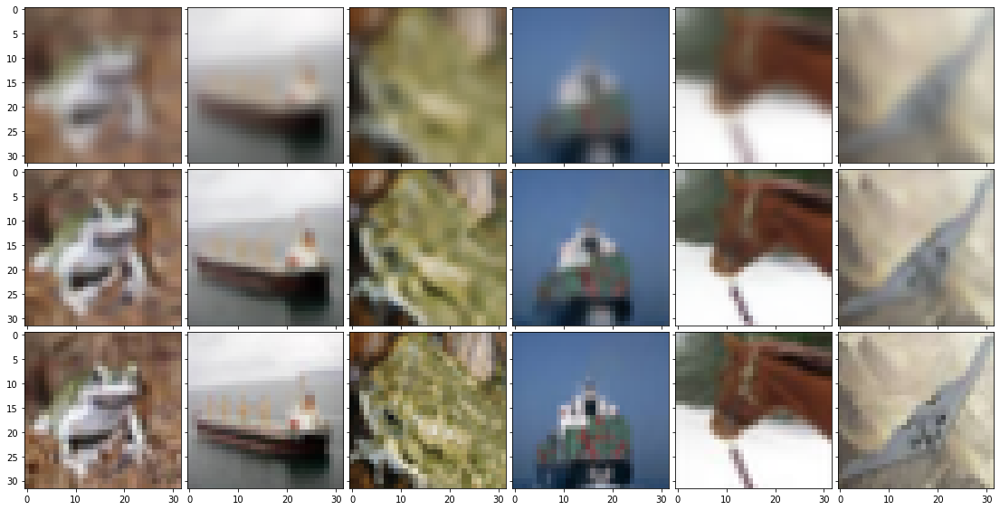

Epoch:  14


 Number of seen samples: 2688 loss: 36870.9591796875
 Number of seen samples: 5248 loss: 36657.378515625
 Number of seen samples: 7808 loss: 36527.0119140625
 Number of seen samples: 10368 loss: 36026.0625
 Number of seen samples: 12928 loss: 36224.4873046875
 Number of seen samples: 15488 loss: 36892.9625
 Number of seen samples: 18048 loss: 36351.830078125
 Number of seen samples: 20608 loss: 36753.3021484375
 Number of seen samples: 23168 loss: 35901.219921875
 Number of seen samples: 25728 loss: 36326.785546875
 Number of seen samples: 28288 loss: 36636.5662109375
 Number of seen samples: 30848 loss: 36757.920703125
 Number of seen samples: 33408 loss: 36327.4375
 Number of seen samples: 35968 loss: 36689.8916015625
 Number of seen samples: 38528 loss: 36304.7380859375
 Number of seen samples: 41088 loss: 36497.1322265625
 Number of seen samples: 43648 loss: 36426.0986328125
 Number of seen samples: 46208 loss: 36295.752734375
 Number of seen samples: 48768 loss: 36705.9412109375




Test loss:  37048.973


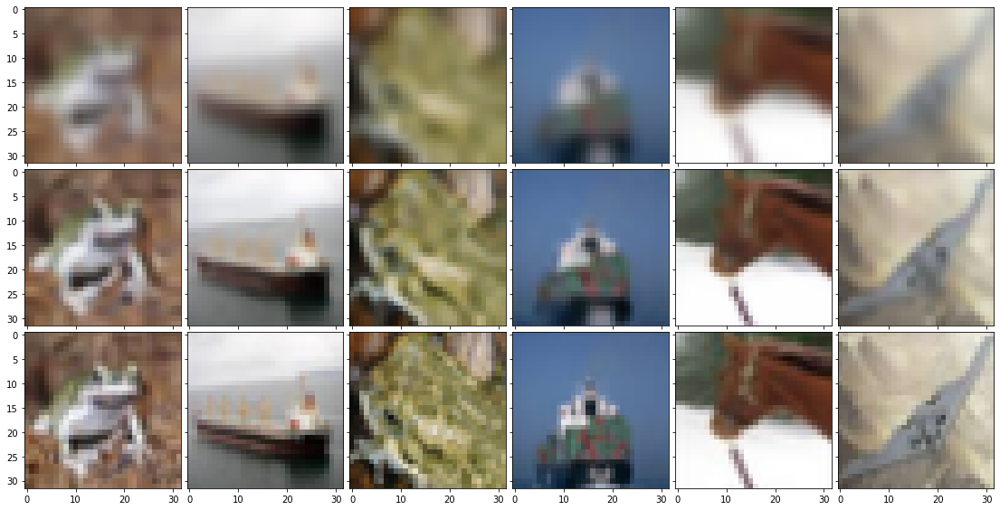

Epoch:  15


 Number of seen samples: 2688 loss: 36557.45234375
 Number of seen samples: 5248 loss: 36436.056640625
 Number of seen samples: 7808 loss: 36649.4451171875
 Number of seen samples: 10368 loss: 36661.2982421875
 Number of seen samples: 12928 loss: 36639.771484375
 Number of seen samples: 15488 loss: 36401.525390625
 Number of seen samples: 18048 loss: 36246.4859375
 Number of seen samples: 20608 loss: 36543.0958984375
 Number of seen samples: 23168 loss: 36402.2478515625
 Number of seen samples: 25728 loss: 36113.9705078125
 Number of seen samples: 28288 loss: 36588.298828125
 Number of seen samples: 30848 loss: 35718.419140625
 Number of seen samples: 33408 loss: 36406.1533203125
 Number of seen samples: 35968 loss: 36321.934375
 Number of seen samples: 38528 loss: 36211.1224609375
 Number of seen samples: 41088 loss: 36089.7318359375
 Number of seen samples: 43648 loss: 36527.534765625
 Number of seen samples: 46208 loss: 36227.2185546875
 Number of seen samples: 48768 loss: 36586.853


Test loss:  36650.598


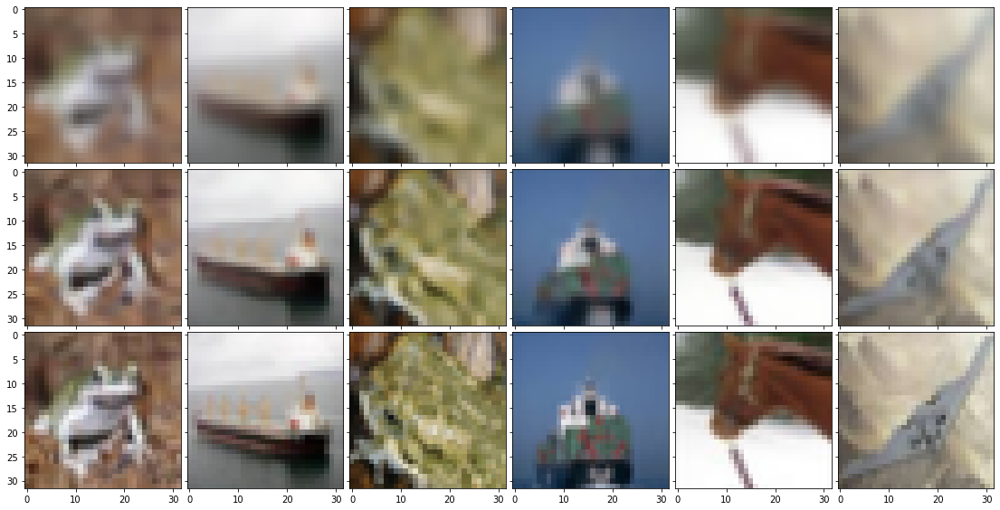

Epoch:  16


 Number of seen samples: 2688 loss: 36159.703125
 Number of seen samples: 5248 loss: 35989.28671875
 Number of seen samples: 7808 loss: 35879.7025390625
 Number of seen samples: 10368 loss: 36867.4884765625
 Number of seen samples: 12928 loss: 36505.4060546875
 Number of seen samples: 15488 loss: 35822.78984375
 Number of seen samples: 18048 loss: 36616.041015625
 Number of seen samples: 20608 loss: 36658.0240234375
 Number of seen samples: 23168 loss: 36482.82109375
 Number of seen samples: 25728 loss: 36414.7646484375
 Number of seen samples: 28288 loss: 36014.058984375
 Number of seen samples: 30848 loss: 36070.05625
 Number of seen samples: 33408 loss: 36389.21640625
 Number of seen samples: 35968 loss: 36396.9990234375
 Number of seen samples: 38528 loss: 35702.7306640625
 Number of seen samples: 41088 loss: 36116.4234375
 Number of seen samples: 43648 loss: 36018.4146484375
 Number of seen samples: 46208 loss: 36354.514453125
 Number of seen samples: 48768 loss: 36275.598828125




Test loss:  36586.445


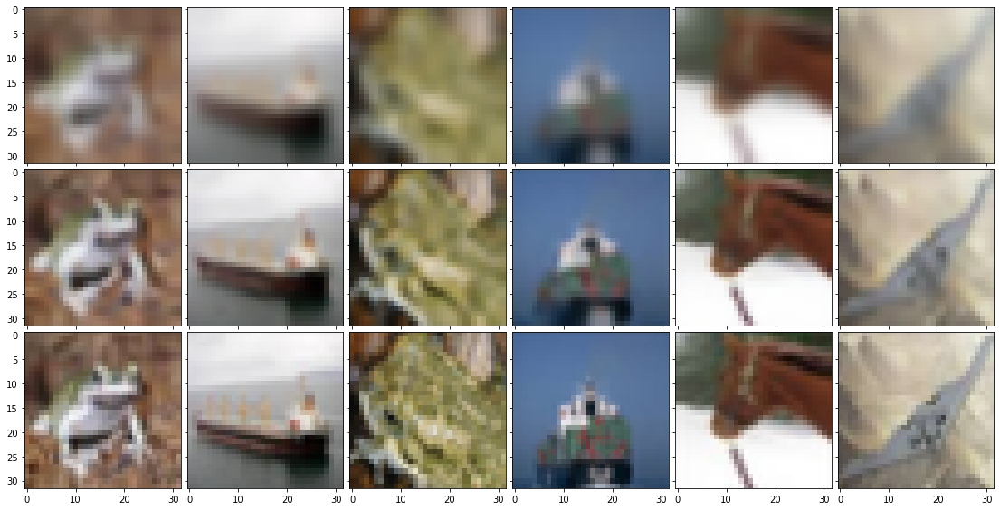

Epoch:  17


 Number of seen samples: 2688 loss: 36304.5607421875
 Number of seen samples: 5248 loss: 35899.07265625
 Number of seen samples: 7808 loss: 36284.37890625
 Number of seen samples: 10368 loss: 36331.03515625
 Number of seen samples: 12928 loss: 35955.962890625
 Number of seen samples: 15488 loss: 36030.4017578125
 Number of seen samples: 18048 loss: 36374.5603515625
 Number of seen samples: 20608 loss: 36142.913671875
 Number of seen samples: 23168 loss: 36397.8451171875
 Number of seen samples: 25728 loss: 35741.809375
 Number of seen samples: 28288 loss: 36029.96953125
 Number of seen samples: 30848 loss: 35898.7345703125
 Number of seen samples: 33408 loss: 36369.4564453125
 Number of seen samples: 35968 loss: 36155.0521484375
 Number of seen samples: 38528 loss: 36347.95546875
 Number of seen samples: 41088 loss: 36095.24765625
 Number of seen samples: 43648 loss: 36152.3611328125
 Number of seen samples: 46208 loss: 36109.46875
 Number of seen samples: 48768 loss: 36007.924609375




Test loss:  36544.508


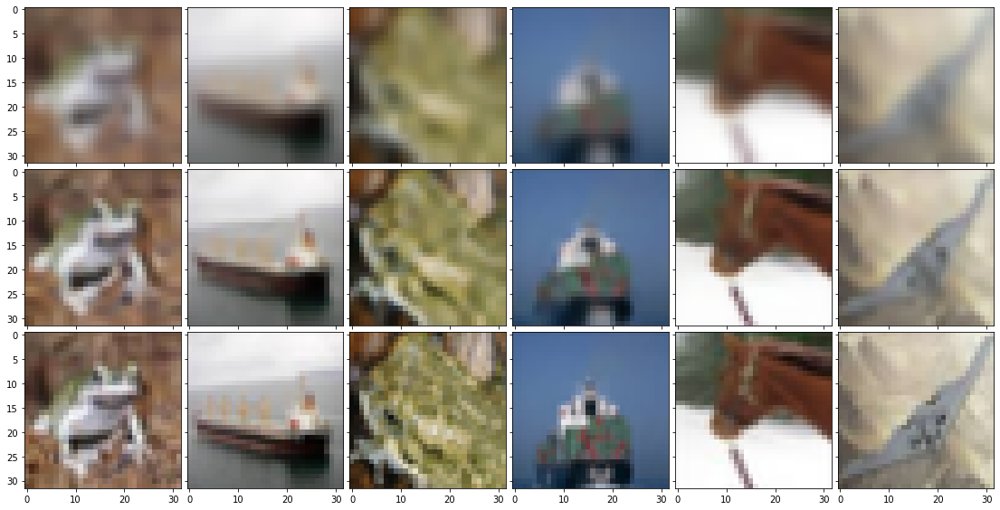

Epoch:  18


 Number of seen samples: 2688 loss: 36092.3033203125
 Number of seen samples: 5248 loss: 35933.47421875
 Number of seen samples: 7808 loss: 35803.9216796875
 Number of seen samples: 10368 loss: 36144.3166015625
 Number of seen samples: 12928 loss: 35530.3767578125
 Number of seen samples: 15488 loss: 35891.82265625
 Number of seen samples: 18048 loss: 36265.8158203125
 Number of seen samples: 20608 loss: 35712.227734375
 Number of seen samples: 23168 loss: 36412.734765625
 Number of seen samples: 25728 loss: 36087.03984375
 Number of seen samples: 28288 loss: 35562.8236328125
 Number of seen samples: 30848 loss: 35757.9005859375
 Number of seen samples: 33408 loss: 36361.801953125
 Number of seen samples: 35968 loss: 36130.9796875
 Number of seen samples: 38528 loss: 36259.90625
 Number of seen samples: 41088 loss: 36237.8025390625
 Number of seen samples: 43648 loss: 36309.85546875
 Number of seen samples: 46208 loss: 35925.6599609375
 Number of seen samples: 48768 loss: 35867.2699218


Test loss:  36608.57


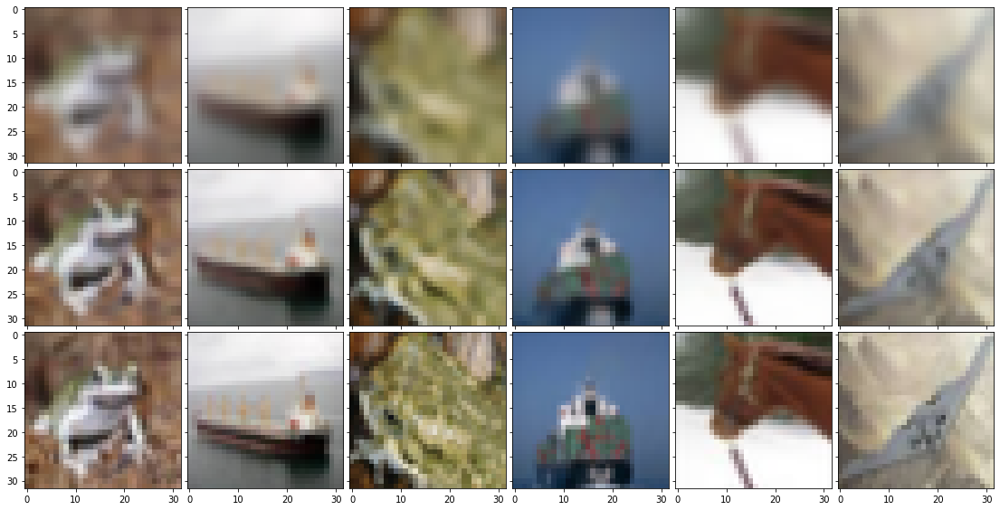

Epoch:  19


 Number of seen samples: 2688 loss: 35851.567578125
 Number of seen samples: 5248 loss: 36071.1771484375
 Number of seen samples: 7808 loss: 36104.1392578125
 Number of seen samples: 10368 loss: 35981.9529296875
 Number of seen samples: 12928 loss: 35834.9224609375
 Number of seen samples: 15488 loss: 36289.023828125
 Number of seen samples: 18048 loss: 35677.144140625
 Number of seen samples: 20608 loss: 35857.5109375
 Number of seen samples: 23168 loss: 35795.945703125
 Number of seen samples: 25728 loss: 35686.7130859375
 Number of seen samples: 28288 loss: 35930.19375
 Number of seen samples: 30848 loss: 35793.71875
 Number of seen samples: 33408 loss: 36052.8587890625
 Number of seen samples: 35968 loss: 36098.046875
 Number of seen samples: 38528 loss: 35882.3392578125
 Number of seen samples: 41088 loss: 35660.365234375
 Number of seen samples: 43648 loss: 35830.3974609375
 Number of seen samples: 46208 loss: 35649.2470703125
 Number of seen samples: 48768 loss: 36109.899609375



Test loss:  36426.555


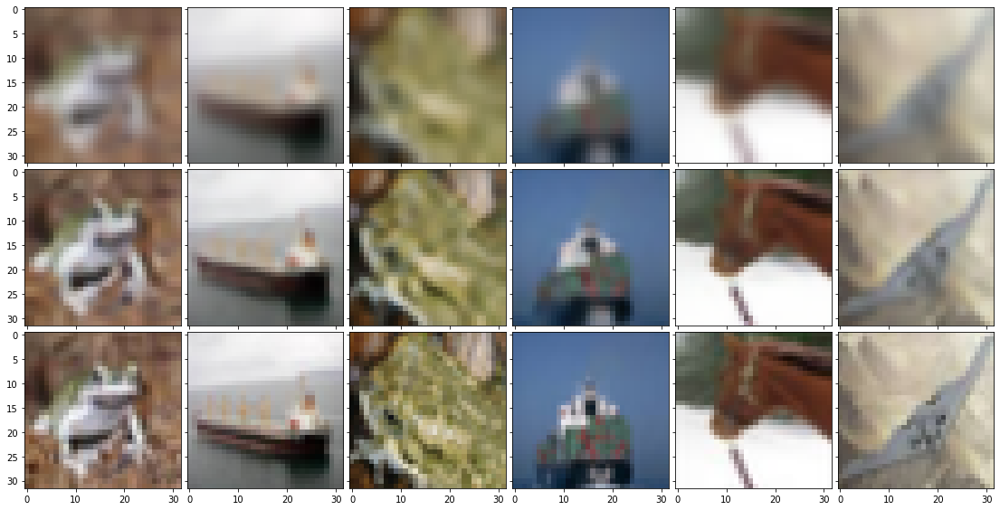

Epoch:  20


 Number of seen samples: 2688 loss: 35860.263671875
 Number of seen samples: 5248 loss: 35466.84208984375
 Number of seen samples: 7808 loss: 35349.676171875
 Number of seen samples: 10368 loss: 35596.1185546875
 Number of seen samples: 12928 loss: 35455.45
 Number of seen samples: 15488 loss: 36362.36796875
 Number of seen samples: 18048 loss: 35932.352734375
 Number of seen samples: 20608 loss: 36083.1994140625
 Number of seen samples: 23168 loss: 36192.3908203125
 Number of seen samples: 25728 loss: 35983.9125
 Number of seen samples: 28288 loss: 35759.8666015625
 Number of seen samples: 30848 loss: 36127.335546875
 Number of seen samples: 33408 loss: 35743.385546875
 Number of seen samples: 35968 loss: 35711.25625
 Number of seen samples: 38528 loss: 35900.1861328125
 Number of seen samples: 41088 loss: 35633.1146484375
 Number of seen samples: 43648 loss: 35715.3375
 Number of seen samples: 46208 loss: 35434.3234375
 Number of seen samples: 48768 loss: 35763.0560546875

Model Eval


Test loss:  36573.848


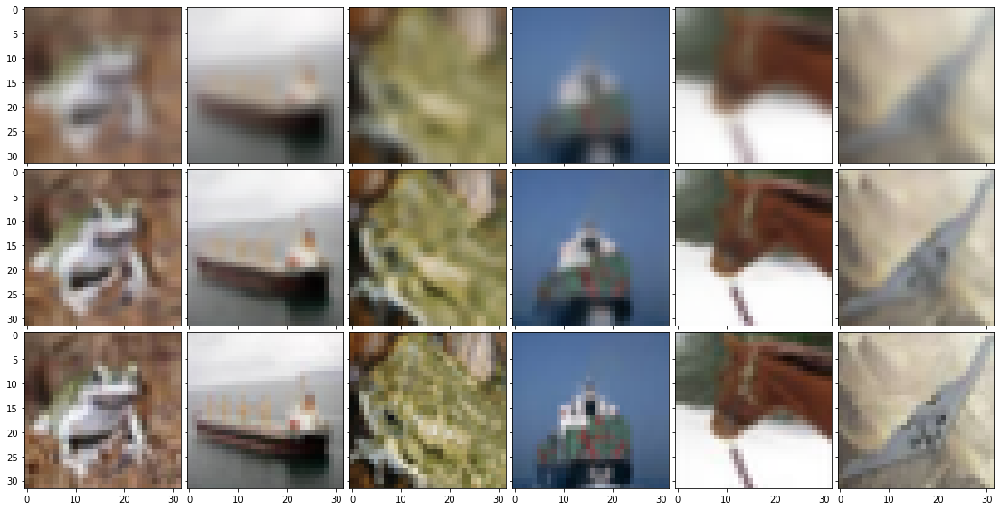

In [113]:
ENV.epochs = 20
ENV.log_step = 20

# criterion = torch.nn.MSELoss()
criterion = my_loss(alpha_1=1.0, alpha_2=0.1)
# optimizer = torch.optim.RMSprop(model.parameters(), lr=1e-3)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)

nsamples = 6
samples_idxs = np.random.choice(ENV.batch_size, nsamples, replace=False)

for epoch in range(ENV.epochs):
    model.train()

    losses = []

    print("Epoch: ", epoch + 1)
    for nbatch, (x_data, y_data) in tqdm(enumerate(train_loader, 1), ascii=True, total=len(train_loader)):
        inputs, targets = x_data.to(ENV.device), y_data.to(ENV.device)
        # zero the parameter gradients
        optimizer.zero_grad()

        # forward + backward + optimize
        y_pred = model(inputs)
        loss = criterion(y_pred, targets)
        loss.backward()
        optimizer.step()

        losses.append(loss.item())
        if nbatch % ENV.log_step == 0:
            tqdm.write(" Number of seen samples: {} loss: {}".format((nbatch + 1) * ENV.batch_size, np.mean(losses)))
            losses = []

    print("Model Evaluation on test data")
    last_out = test_evaluation(model)

    show_samples(last_out[0].cpu().numpy(), last_out[1].cpu().numpy(), last_out[2].cpu().numpy(), samples_idxs, nsamples)


In [114]:
torch.save(model.state_dict(), './model')

Con 20 épocas ya se ven buenos resultados aunque analizando los errores del entreniento aun puede mejorar más si le damos más épocas. Para fines prácticos lo dejamos en solo 20.

## Prueba en imágenes random

In [115]:
model.load_state_dict(torch.load('./model'))

<All keys matched successfully>

In [116]:
def super_res(model, image, factor=None):
    """ Aplica el modelo a una imágen para aunmentar la resolucion con cierto factor
        Retorna la imagen original rescalada usando PIL con el método NEAREST y la imagen
        rescalada por la red neuraonal 
    """
    # Reescalamos por un factor de 'factor'
    image2x = img.resize((img.width * 2, img.height * 2))
    
    resize = lambda img: img.resize((img.width // 2, img.height // 2))
    if factor is not None:
        image = resize(image)

    # A tensores y normalizamos la imágen
    tmp_transform = transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
    ])
    inputs = tmp_transform(image)
    inputs = inputs.view((-1, *inputs.shape))
    
    model.eval()
    with torch.no_grad():
        output = model(inputs.to(ENV.device))
    
    # Pasamos de {-1, - 1} a {0, - 1} y a los ejes correspondientes
    output = output[0].cpu().numpy()
    output = output / 2 + 0.5
    output = np.transpose(output, (1, 2, 0))

    # En el rango de 0 a 1 para evitar overflow cuando se convierte en a uint8
    output[output < 0] = 0
    output[output > 1] = 1

    # a PIL Image
    output = np.uint8(output*255)
    output = Image.fromarray(output)

    return image2x, output

## Resultados y comentarios

In [117]:
def get_concat_h(im1, im2):
    dst = Image.new('RGB', (im1.width + im2.width, im1.height))
    dst.paste(im1, (0, 0))
    dst.paste(im2, (im1.width, 0))
    return dst

### Perro

In [118]:
img = Image.open("./data/perro.jpg")
img.width, img.height

(500, 300)

In [119]:
# A una resolución válida
# para que se pueda hacer hacer un max pooling sin perder alguna dimensión al recuperar
img = img.resize((544, 320))
img.height, img.width

(320, 544)

#### Imagen original

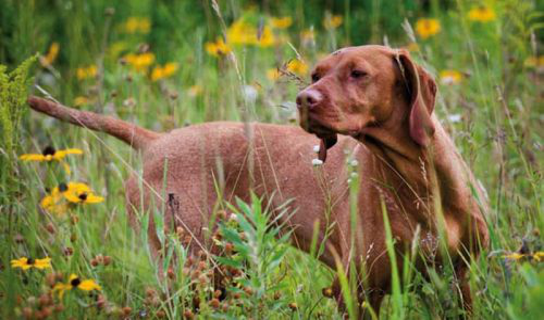

In [120]:
img

#### Imagen 2x

In [121]:
r_img, s_img = super_res(model, img, factor=None)

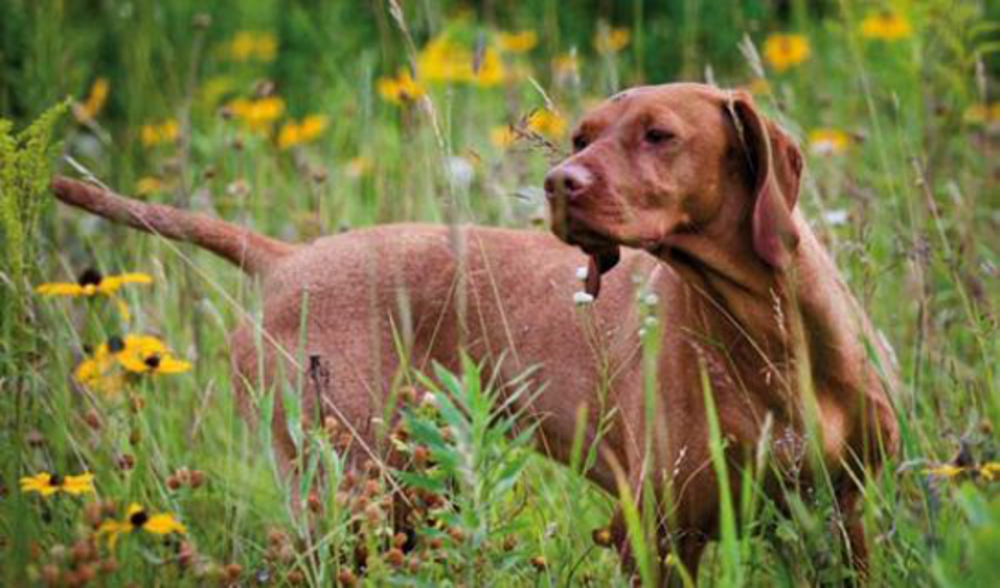

In [122]:
r_img

#### Imagen 2x Network

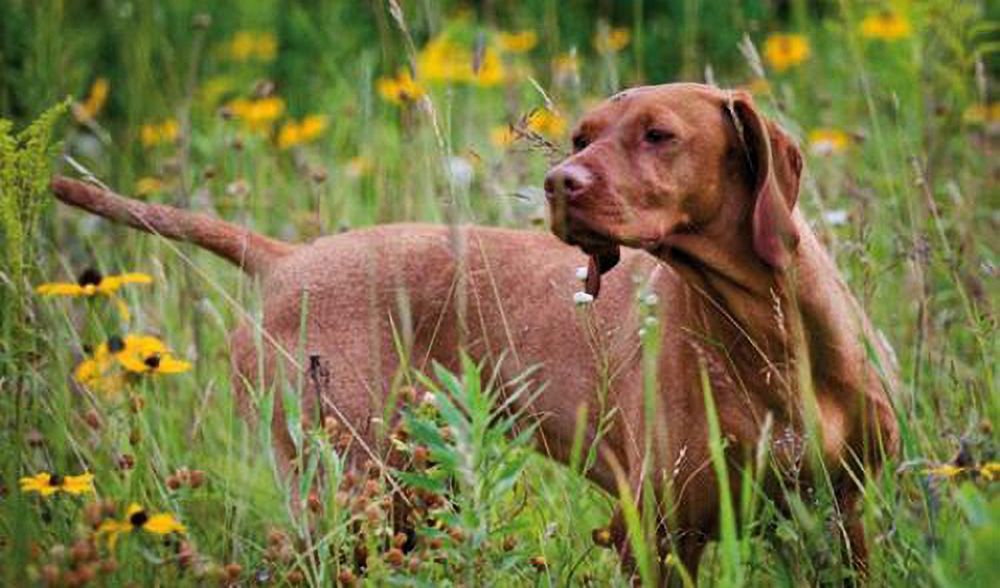

In [123]:
s_img

#### Imagen 2x Network, dos veces 

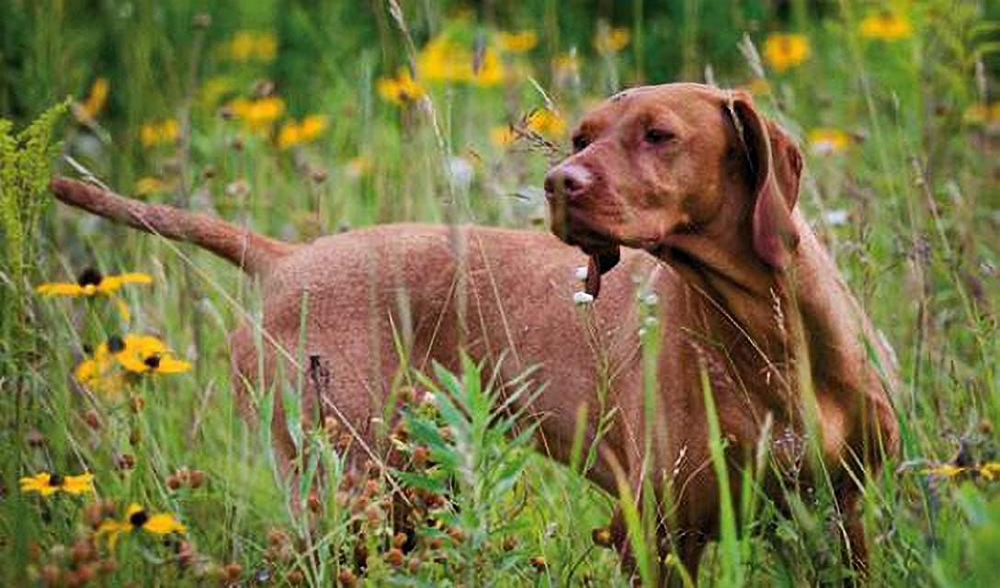

In [124]:
_, ss_img = super_res(model, s_img, factor=2)
ss_img

##### Comparaciones

In [125]:
r_img.height, r_img.width

(640, 1088)

PIL.IMAGE.NEAREST + Network primera vez + Network segunda vez

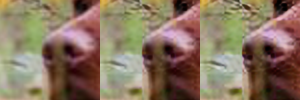

In [126]:
area = (550, 150, 650, 250)
get_concat_h(get_concat_h(r_img.crop(area), s_img.crop(area)), ss_img.crop(area))

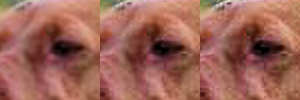

In [127]:
area = (650, 100, 750, 200)
get_concat_h(get_concat_h(r_img.crop(area), s_img.crop(area)), ss_img.crop(area))

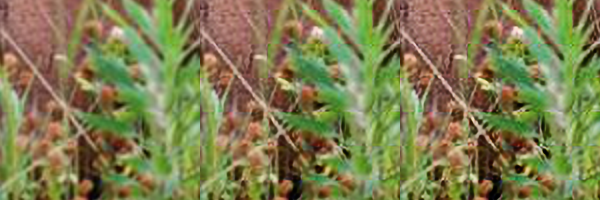

In [128]:
area = (350, 400, 550, 600)
get_concat_h(get_concat_h(r_img.crop(area), s_img.crop(area)), ss_img.crop(area))

Las comparaciones mostradas arriba muestran un zoom sobre una región en especial de la imagen de entrada.
La parte más a la izquierda es la imagen duplicada de tamaño usando PIL a través del método NEAREST para el reescalado. La parte de en medio muestra el rescalado hecho por la red y parte derecha muestra la salida de al procesar la imágen dos veces sobre la red.

Vemos una mejor definición de la nariz y de los ojos, así como de la textura de las plantas y botones en comparación de hacer un reescalado con un método tradicional (en este caso NEAREST de PIL). 

### Personas

In [129]:
img = Image.open("./data/personas.jpg")
img.width, img.height

(1000, 623)

In [130]:
# A una resolución válida
# para que se pueda hacer hacer un max pooling sin perder alguna dimensión al recuperar
img = img.resize((1024, 640))
img.width, img.height

(1024, 640)

#### Imagen original

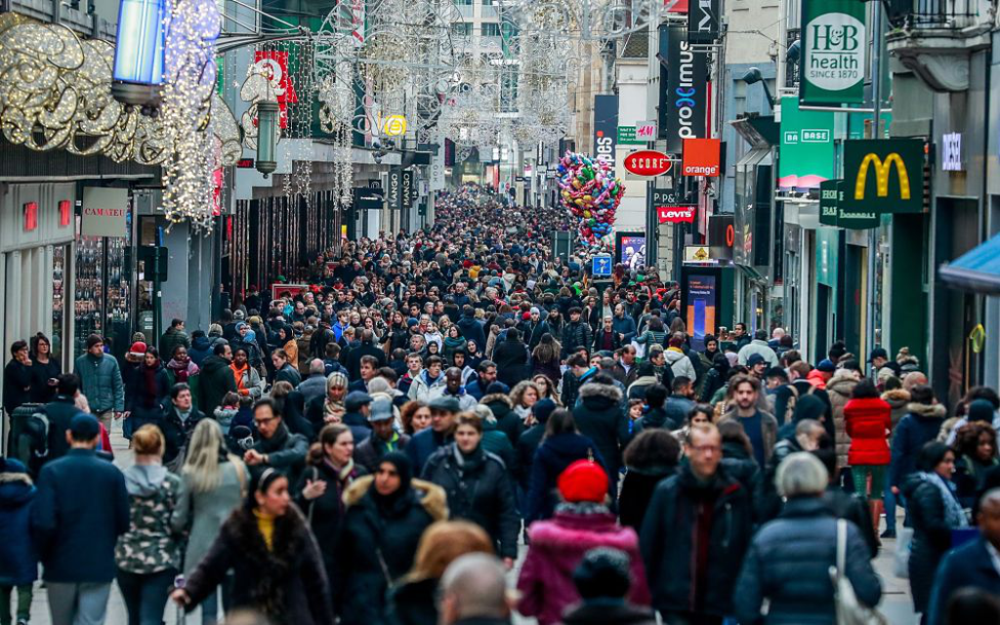

In [131]:
img

#### Imagen 2x, default: PIL.Image.NEAREST

In [132]:
r_img, s_img = super_res(model, img, factor=None)

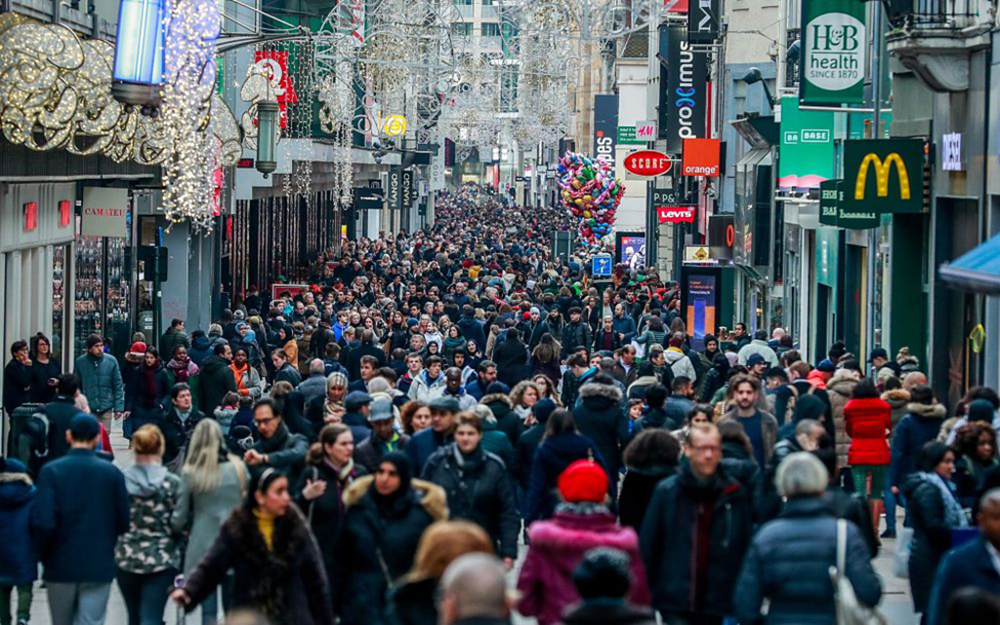

In [133]:
r_img

#### Imagen 2x: Network

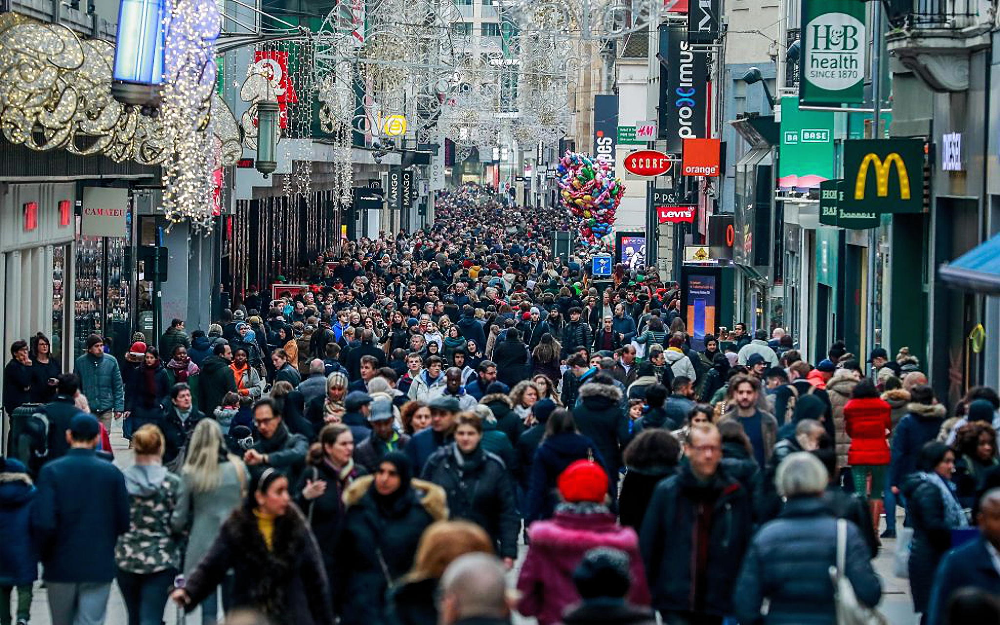

In [134]:
s_img

#### Imagen 2x Network, dos veces

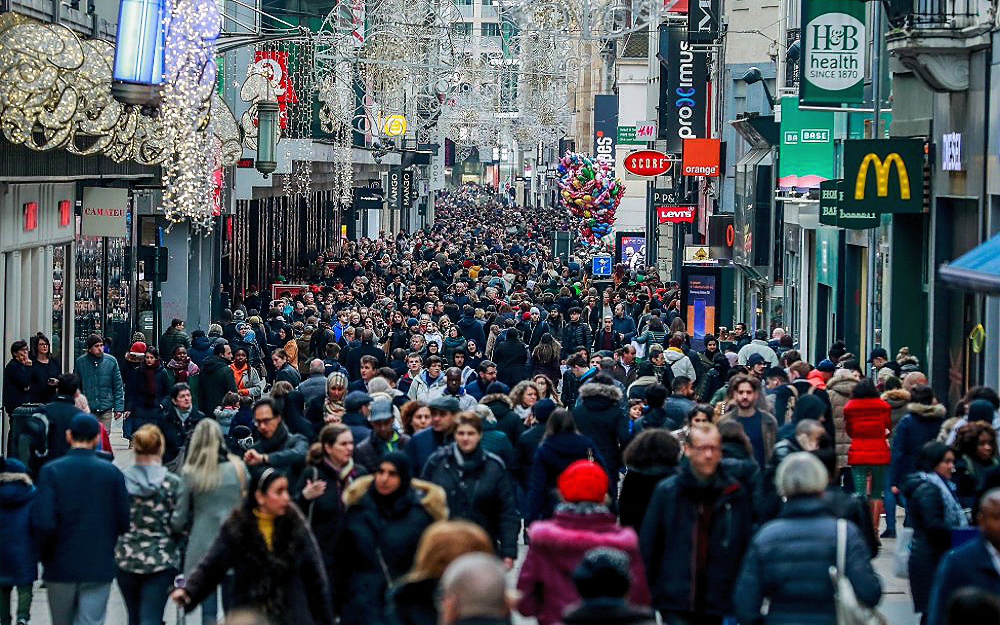

In [135]:
_, ss_img = super_res(model, s_img, factor=2)
ss_img

#### Algunas comparaciones

In [136]:
r_img.height, r_img.width

(1280, 2048)

PIL.IMAGE.NEAREST + Network primera vez + Network segunda vez

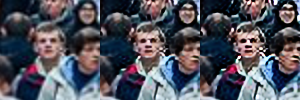

In [137]:
area = (800, 700, 900, 800)
get_concat_h(get_concat_h(r_img.crop(area), s_img.crop(area)), ss_img.crop(area))

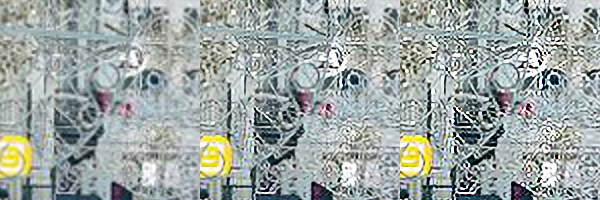

In [138]:
area = (800, 100, 1000, 300)
get_concat_h(get_concat_h(r_img.crop(area), s_img.crop(area)), ss_img.crop(area))

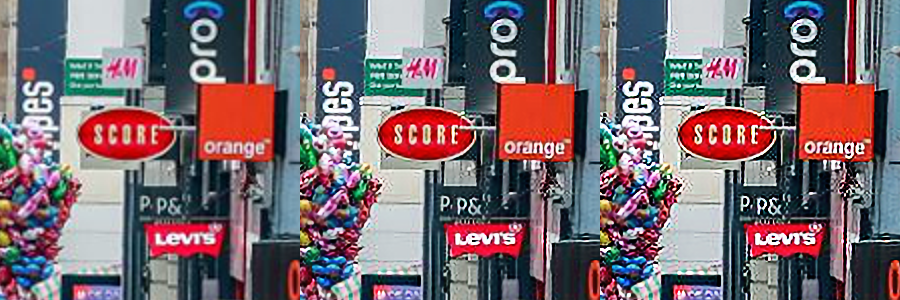

In [139]:
area = (1200, 200, 1500, 500)
get_concat_h(get_concat_h(r_img.crop(area), s_img.crop(area)), ss_img.crop(area))

En este segundo ejemplo tantos los rostros de las personsas como las letras son mejore definidas y ciertas estrucuturas de objetos son mucho mejor definidas que usar un método de reescalado tradicional. 

Precisamente el ingresar el error del gradiente sobre el borde de los objetos al error de MSE sobre los inputs y los targets nos permite tener una mejor definición de este. Sin embargo en este caso aparece un efecto curioso. Parece haber una linea blanca entre la multitud que definie los cuerpos de las personas. Se le puede atribuir a un efecto secundario de la cantidad que pondera el error del gradiente usando el operador de Sobel.